In [1]:
from maliboo import BayesianOptimization, UtilityFunction
import numpy as np
import os

import matplotlib.pyplot as plt
from matplotlib import gridspec
%matplotlib inline

import pandas as pd
import time

import warnings

# Gramacy 

In [2]:
# Gramacy
def target(x,y):
    return -(x + y)

In [3]:
### Gramacy et al 
import warnings
def posterior(optimizer, x_obs, y_obs, grid):
    optimizer._gp.fit(x_obs, y_obs)
    mu, sigma = optimizer._gp.predict(grid, return_std=True)
    return mu, sigma

def plot_gp(optimizer, x, y, show_minimized=False, style='transparent'):

    if style == 'classic':
        plt.style.use(style)
    elif style == 'dark':
        plt.style.use('dark_background')
    elif style == 'transparent':
        pass
    else:
        raise ValueError("Wrong style")

    # Swap sign of stuff
    sign = -1 if show_minimized else 1
    
    # Set up complete plot
    plt.rcParams.update({'font.size': 20})

    fig = plt.figure(figsize=(16, 10))
    steps = len(optimizer.space)
    gs = gridspec.GridSpec(2, 1, height_ratios=[3, 1]) 
    axis = plt.subplot(gs[0])
    acq = plt.subplot(gs[1])

    ## MAIN PLOT
    # Plot true objective
    target_col = 'limegreen' if style == 'dark' else 'gray'
    axis.plot(x, sign*y, linewidth=3.5, label='objective function',
              color=target_col)
    # Plot observations
    x_obs = np.array([[res["x"]] for res in optimizer.res])
    y_obs = np.array([res["target"] for res in optimizer.res])
    axis.scatter(x_obs, sign*y_obs, marker='o', s=300,
                 label='observations', color='red', zorder=10)   
    # Plot mean function
    mu, sigma = posterior(optimizer, x_obs, y_obs, x)
    mu = sign * mu
    axis.plot(x, mu, dashes=(12, 3.5), color='blue', lw=2.5, label='mean prediction')
    # Plot credible interval
    quant = 1.96
    axis.fill(np.concatenate([x, x[::-1]]), 
              np.concatenate([mu - quant * sigma, (mu + quant * sigma)[::-1]]),
        alpha=.6, fc='paleturquoise', ec='None', label='95% credible interval')
    # Set parameters
    xlim = (-2,10)
    axis.set_xlim(xlim)
    axis.set_xlabel('x')
    axis.set_ylim(-1.61, 0.01)
    axis.set_ylabel('objective function')
    axis.legend(loc=2, bbox_to_anchor=(1.01, 1), borderaxespad=0.)

    ## ACQUISITION PLOT
    utility_function = UtilityFunction(kind="ucb", kappa=5, xi=0)
    utility = utility_function.utility(x, optimizer._gp, 0)
    x_next = x[np.argmax(utility)]
    print(x_next)
    acq.plot(x, utility, label='acquisition function', lw=2, color='fuchsia')
    acq.scatter(x_next, np.max(utility), marker='x', s=300, 
             label='next observation', ec='red', lw=4, zorder=10)
    acq.set_xlim(xlim)
    acq.set_ylim((0, 2.501))
    acq.set_ylabel('utility')
    acq.set_xlabel('x')
    acq.legend(loc=2, bbox_to_anchor=(1.01, 1))

    # Vertical lines in both
    axis.vlines(x_next, sign*0, sign*1.6, lw=1.5, linestyle=(0, (10, 3.5)), color='silver')
    acq.vlines(x_next,       0,        5, lw=1.5, linestyle=(0, (10, 3.5)), color='silver')

    # Overlay vertical Gaussian distribution
    ypos_idx = np.abs(x-x_next).argmin()
    ypos = mu[ypos_idx]
    var = 0.6 * sigma[ypos_idx]  # I'm cheating a little bit with the variance
                                 # for representation purposes
    bound = 0.5
    supp = np.linspace(-bound, bound, 1000).reshape(-1, 1)
    gaussian = np.exp((-supp ** 2.0) / (2 * var ** 2.0))
    gaussian /= gaussian.max()
    gaussian *= -0.5  # height
    axis.plot(gaussian + x_next, supp + ypos, lw=1.5, color='silver')

    # Save to file
    for fmt in ('png', 'svg'):
        filename = f'bo_{style}_{len(x_obs)}.{fmt}'
        plt.savefig(os.path.join('resources', filename), bbox_inches='tight', dpi=300)

# # UCB
# # Initialize optimizer
# optimizer = BayesianOptimization(target, {'x': (-2, 10)},
#                                  random_state=272242)
# # First rounds of optimization
# optimizer.maximize(init_points=3, n_iter=1, kappa=5)
# for style in ('classic', 'dark'):  # ('transparent', 'classic', 'dark')
#     plot_gp(optimizer, x, y, show_minimized=True, style=style)

# EB
# Initialize optimizer again
optimizer = BayesianOptimization(target, {'x': (0,1)
                                          ,'y': (0,1)
                                           }, 
                                 random_state=27222,barrier_func={'constraint1': lambda x,y: 3/2 -x-2*y - 1/2*np.sin(2*np.pi*(x**2 - 2*y)),
                                                                  'constraint2': lambda x,y: x**2 + y**2 - 3/2
                                                                  }, debug = True)
# Other rounds of optimization
with warnings.catch_warnings():
    warnings.simplefilter("ignore", RuntimeWarning)
    warnings.simplefilter("ignore", FutureWarning)
    optimizer.maximize(init_points=10, n_iter=120,acq='eb',mean_p = 1.,std_p = 1.,acq_info={'static_lambda':False})


Initializing TargetSpace with bounds: {'x': (0, 1), 'y': (0, 1)}
initialize_dataset(): dataset is None
TargetSpace initialization completed
BayesianOptimization initialization completed
Starting maximize()
|   iter    |  target   |     x     |     y     |
-------------------------------------------------
_prime_queue(): initializing 10 random points
Uniform randomly sampled point: value [[0.07519784 0.52681689]]
Uniform randomly sampled point: value [[0.32681975 0.86190258]]
Uniform randomly sampled point: value [[0.61254226 0.34574648]]
Uniform randomly sampled point: value [[0.80114922 0.45265681]]
Uniform randomly sampled point: value [[0.12850917 0.61009722]]
Uniform randomly sampled point: value [[0.4140246  0.22827787]]
Uniform randomly sampled point: value [[0.54206149 0.78481709]]
Uniform randomly sampled point: value [[0.77107487 0.97016069]]
Uniform randomly sampled point: value [[0.2238236 0.1646788]]
Uniform randomly sampled point: value [[0.97405925 0.06397921]]
Initializi

## Montecarlo Gramacy

In [5]:
np.random.seed(42)
num_runs = 30
niter = 120
ninit = 10
seed_vec = np.empty(num_runs, dtype = int)

# generate a seed for every Monte Carlo run
for run in range(num_runs):
    seed_vec[run] = np.random.randint(1, 10000)
# seed_vec[i] is the same for every acquisition function so that the initial random points are the same
    
columns = [name for run in range(num_runs) for name in [f'max_target_{run + 1}', f'target_{run + 1}']]

In [6]:
best_results_oos = pd.DataFrame(columns=columns)

# runs 30 MC repetitions with Expected Barrier method, OOS version
for run in range(num_runs):
    print(f'MC repetition: {run}')
    optimizer = BayesianOptimization(target, {'x': (0.1, 1), 'y': (0, 1)}, random_state=int(seed_vec[run]),
                                     barrier_func={'constraint1': lambda x,y: 3/2 -x-2*y - 1/2*np.sin(2*np.pi*(x**2 - 2*y)),
                                                   'constraint2': lambda x,y: x**2 + y**2 - 3/2},
                                     debug = True)

    # 120 evaluations of target function
    with warnings.catch_warnings():
        warnings.simplefilter("ignore", RuntimeWarning)
        warnings.simplefilter("ignore", FutureWarning)
        optimizer.maximize(
            init_points=ninit, 
            n_iter=niter, acq='eb',mean_p = 1.,std_p = 1.,acq_info={'static_lambda':False}
        )
        
    results_df = pd.read_csv('results.csv', usecols=['target'])
    results_df = results_df.iloc[ninit:].reset_index(drop=True)

    modified_values = []
    for i in range(len(results_df)):
        if i == 0:
            value = results_df.iloc[i]['target'] if results_df.iloc[i]['target'] <= optimizer.max['target'] else 0
        else:
            value = results_df.iloc[i]['target'] if results_df.iloc[i]['target'] <= optimizer.max['target'] else modified_values[i-1]
        modified_values.append(value)

    # results_df['target'] = modified_values

    # running_max = np.maximum.accumulate(results_df['target'])

    best_results_oos[f'max_target_{run + 1}'] = np.maximum.accumulate(modified_values)
    best_results_oos[f'target_{run + 1}'] = results_df['target']

max_target_columns = [col for col in best_results_oos.columns if col.startswith('max_target_')]
average_best_oos = pd.DataFrame(best_results_oos[max_target_columns].mean(axis=1), columns=['average_best_target'])

MC repetition: 0
Initializing TargetSpace with bounds: {'x': (0.1, 1), 'y': (0, 1)}
initialize_dataset(): dataset is None
TargetSpace initialization completed
BayesianOptimization initialization completed
Starting maximize()
|   iter    |  target   |     x     |     y     |
-------------------------------------------------
_prime_queue(): initializing 10 random points
Uniform randomly sampled point: value [[0.63621712 0.2975028 ]]
Uniform randomly sampled point: value [[0.44491955 0.52489355]]
Uniform randomly sampled point: value [[0.86205065 0.09912029]]
Uniform randomly sampled point: value [[0.95042648 0.61489657]]
Uniform randomly sampled point: value [[0.79082051 0.75873782]]
Uniform randomly sampled point: value [[0.72839553 0.43024722]]
Uniform randomly sampled point: value [[0.34300091 0.39493647]]
Uniform randomly sampled point: value [[0.21497078 0.80786397]]
Uniform randomly sampled point: value [[0.15647599 0.95705259]]
Uniform randomly sampled point: value [[0.48452013 0.

Saved current results to /Users/niccoloferesini/Desktop/MALIBOO
New iteration: selected point from queue, index None, value {'x': 0.15647599453240252, 'y': 0.9570525879646876}
No dataset, or dataset for X only: evaluating target function
Probing point: index None, value {'x': 0.15647599453240252, 'y': 0.9570525879646876}
Registering params [0.15647599 0.95705259] with index None and target value -1.1135285824970902
Extracting info: target -1.1135285824970902 is scalar
Point registered successfully
Probed target value: -1.1135285824970902
Probing_barriers at point: index None, value {'x': 0.15647599453240252, 'y': 0.9570525879646876}
Probed barrier_target values: [-0.89021104 -0.55956561]
Point was not selected by suggest(): skipping termination check
Registered optimization information:
      acquisition terminated
None          NaN      False
End of current iteration
++++++++++++++++++++++++
Saved current results to /Users/niccoloferesini/Desktop/MALIBOO
New iteration: selected point 

KeyboardInterrupt: 

In [ ]:
max_target_columns = [col for col in best_results_oos.columns if col.startswith('max_target_')]
average_best_oos = pd.DataFrame(best_results_oos[max_target_columns].mean(axis=1), columns=['average_best_target'])

# Mishra's Bird

In [ ]:
def target(x,y):
    return -(np.sin(y)*np.exp((1-np.cos(x))**2) + np.cos(x)*np.exp((1-np.sin(y))**2) + (x - y)**2)

In [ ]:
import warnings
def posterior(optimizer, x_obs, y_obs, grid):
    optimizer._gp.fit(x_obs, y_obs)
    mu, sigma = optimizer._gp.predict(grid, return_std=True)
    return mu, sigma

def plot_gp(optimizer, x, y, show_minimized=False, style='transparent'):

    if style == 'classic':
        plt.style.use(style)
    elif style == 'dark':
        plt.style.use('dark_background')
    elif style == 'transparent':
        pass
    else:
        raise ValueError("Wrong style")

    # Swap sign of stuff
    sign = -1 if show_minimized else 1
    
    # Set up complete plot
    plt.rcParams.update({'font.size': 20})

    fig = plt.figure(figsize=(16, 10))
    steps = len(optimizer.space)
    gs = gridspec.GridSpec(2, 1, height_ratios=[3, 1]) 
    axis = plt.subplot(gs[0])
    acq = plt.subplot(gs[1])

    ## MAIN PLOT
    # Plot true objective
    target_col = 'limegreen' if style == 'dark' else 'gray'
    axis.plot(x, sign*y, linewidth=3.5, label='objective function',
              color=target_col)
    # Plot observations
    x_obs = np.array([[res["x"]] for res in optimizer.res])
    y_obs = np.array([res["target"] for res in optimizer.res])
    axis.scatter(x_obs, sign*y_obs, marker='o', s=300,
                 label='observations', color='red', zorder=10)   
    # Plot mean function
    mu, sigma = posterior(optimizer, x_obs, y_obs, x)
    mu = sign * mu
    axis.plot(x, mu, dashes=(12, 3.5), color='blue', lw=2.5, label='mean prediction')
    # Plot credible interval
    quant = 1.96
    axis.fill(np.concatenate([x, x[::-1]]), 
              np.concatenate([mu - quant * sigma, (mu + quant * sigma)[::-1]]),
        alpha=.6, fc='paleturquoise', ec='None', label='95% credible interval')
    # Set parameters
    xlim = (-2,10)
    axis.set_xlim(xlim)
    axis.set_xlabel('x')
    axis.set_ylim(-1.61, 0.01)
    axis.set_ylabel('objective function')
    axis.legend(loc=2, bbox_to_anchor=(1.01, 1), borderaxespad=0.)

    ## ACQUISITION PLOT
    utility_function = UtilityFunction(kind="ucb", kappa=5, xi=0)
    utility = utility_function.utility(x, optimizer._gp, 0)
    x_next = x[np.argmax(utility)]
    print(x_next)
    acq.plot(x, utility, label='acquisition function', lw=2, color='fuchsia')
    acq.scatter(x_next, np.max(utility), marker='x', s=300, 
             label='next observation', ec='red', lw=4, zorder=10)
    acq.set_xlim(xlim)
    acq.set_ylim((0, 2.501))
    acq.set_ylabel('utility')
    acq.set_xlabel('x')
    acq.legend(loc=2, bbox_to_anchor=(1.01, 1))

    # Vertical lines in both
    axis.vlines(x_next, sign*0, sign*1.6, lw=1.5, linestyle=(0, (10, 3.5)), color='silver')
    acq.vlines(x_next,       0,        5, lw=1.5, linestyle=(0, (10, 3.5)), color='silver')

    # Overlay vertical Gaussian distribution
    ypos_idx = np.abs(x-x_next).argmin()
    ypos = mu[ypos_idx]
    var = 0.6 * sigma[ypos_idx]  # I'm cheating a little bit with the variance
                                 # for representation purposes
    bound = 0.5
    supp = np.linspace(-bound, bound, 1000).reshape(-1, 1)
    gaussian = np.exp((-supp ** 2.0) / (2 * var ** 2.0))
    gaussian /= gaussian.max()
    gaussian *= -0.5  # height
    axis.plot(gaussian + x_next, supp + ypos, lw=1.5, color='silver')

    # Save to file
    for fmt in ('png', 'svg'):
        filename = f'bo_{style}_{len(x_obs)}.{fmt}'
        plt.savefig(os.path.join('resources', filename), bbox_inches='tight', dpi=300)

# with these values it converges seed = 27222
optimizer = BayesianOptimization(target, {'x': (-10,0),'y': (-6.5,0)}, 
                                 random_state=2362,
                                 barrier_func={'constraint1': lambda x,y: (x+5)**2 + (y+5)**2 - 25},
                                 debug = True)
# Other rounds of optimization
with warnings.catch_warnings():
    warnings.simplefilter("ignore", RuntimeWarning)
    warnings.simplefilter("ignore", FutureWarning)
    optimizer.maximize(init_points=10, n_iter=120,acq='eb',mean_p = 1.,std_p = 1.,acq_info={'static_lambda':False})

Initializing TargetSpace with bounds: {'x': (-10, 0), 'y': (-6.5, 0)}
initialize_dataset(): dataset is None
TargetSpace initialization completed
BayesianOptimization initialization completed
Starting maximize()
|   iter    |  target   |     x     |     y     |
-------------------------------------------------
_prime_queue(): initializing 10 random points
Uniform randomly sampled point: value [[-5.69646614 -2.1067203 ]]
Uniform randomly sampled point: value [[-4.49381969 -0.32959849]]
Uniform randomly sampled point: value [[-9.25335596 -4.88925336]]
Uniform randomly sampled point: value [[-3.50573996 -6.12763269]]
Uniform randomly sampled point: value [[-8.32187556 -1.33426687]]
Uniform randomly sampled point: value [[-1.74987611 -5.63665633]]
Uniform randomly sampled point: value [[-6.36428942 -2.7813498 ]]
Uniform randomly sampled point: value [[-7.97073248 -3.38000228]]
Uniform randomly sampled point: value [[-2.21798325 -4.50042004]]
Uniform randomly sampled point: value [[-0.420358

In [ ]:
optimizer.max

{'target': 76.8026561486128,
 'params': {'x': -6.4139970688576815, 'y': -1.5326291848621914}}

# Townsend

In [ ]:
# Townsend
def target(x,y):
    return -(-np.cos((x-0.1)*y)**2-x*np.sin(3*x+y))

In [ ]:
import warnings
def posterior(optimizer, x_obs, y_obs, grid):
    optimizer._gp.fit(x_obs, y_obs)
    mu, sigma = optimizer._gp.predict(grid, return_std=True)
    return mu, sigma

def plot_gp(optimizer, x, y, show_minimized=False, style='transparent'):

    if style == 'classic':
        plt.style.use(style)
    elif style == 'dark':
        plt.style.use('dark_background')
    elif style == 'transparent':
        pass
    else:
        raise ValueError("Wrong style")

    # Swap sign of stuff
    sign = -1 if show_minimized else 1
    
    # Set up complete plot
    plt.rcParams.update({'font.size': 20})

    fig = plt.figure(figsize=(16, 10))
    steps = len(optimizer.space)
    gs = gridspec.GridSpec(2, 1, height_ratios=[3, 1]) 
    axis = plt.subplot(gs[0])
    acq = plt.subplot(gs[1])

    ## MAIN PLOT
    # Plot true objective
    target_col = 'limegreen' if style == 'dark' else 'gray'
    axis.plot(x, sign*y, linewidth=3.5, label='objective function',
              color=target_col)
    # Plot observations
    x_obs = np.array([[res["x"]] for res in optimizer.res])
    y_obs = np.array([res["target"] for res in optimizer.res])
    axis.scatter(x_obs, sign*y_obs, marker='o', s=300,
                 label='observations', color='red', zorder=10)   
    # Plot mean function
    mu, sigma = posterior(optimizer, x_obs, y_obs, x)
    mu = sign * mu
    axis.plot(x, mu, dashes=(12, 3.5), color='blue', lw=2.5, label='mean prediction')
    # Plot credible interval
    quant = 1.96
    axis.fill(np.concatenate([x, x[::-1]]), 
              np.concatenate([mu - quant * sigma, (mu + quant * sigma)[::-1]]),
        alpha=.6, fc='paleturquoise', ec='None', label='95% credible interval')
    # Set parameters
    xlim = (-2,10)
    axis.set_xlim(xlim)
    axis.set_xlabel('x')
    axis.set_ylim(-1.61, 0.01)
    axis.set_ylabel('objective function')
    axis.legend(loc=2, bbox_to_anchor=(1.01, 1), borderaxespad=0.)

    ## ACQUISITION PLOT
    utility_function = UtilityFunction(kind="ucb", kappa=5, xi=0)
    utility = utility_function.utility(x, optimizer._gp, 0)
    x_next = x[np.argmax(utility)]
    print(x_next)
    acq.plot(x, utility, label='acquisition function', lw=2, color='fuchsia')
    acq.scatter(x_next, np.max(utility), marker='x', s=300, 
             label='next observation', ec='red', lw=4, zorder=10)
    acq.set_xlim(xlim)
    acq.set_ylim((0, 2.501))
    acq.set_ylabel('utility')
    acq.set_xlabel('x')
    acq.legend(loc=2, bbox_to_anchor=(1.01, 1))

    # Vertical lines in both
    axis.vlines(x_next, sign*0, sign*1.6, lw=1.5, linestyle=(0, (10, 3.5)), color='silver')
    acq.vlines(x_next,       0,        5, lw=1.5, linestyle=(0, (10, 3.5)), color='silver')

    # Overlay vertical Gaussian distribution
    ypos_idx = np.abs(x-x_next).argmin()
    ypos = mu[ypos_idx]
    var = 0.6 * sigma[ypos_idx]  # I'm cheating a little bit with the variance
                                 # for representation purposes
    bound = 0.5
    supp = np.linspace(-bound, bound, 1000).reshape(-1, 1)
    gaussian = np.exp((-supp ** 2.0) / (2 * var ** 2.0))
    gaussian /= gaussian.max()
    gaussian *= -0.5  # height
    axis.plot(gaussian + x_next, supp + ypos, lw=1.5, color='silver')

    # Save to file
    for fmt in ('png', 'svg'):
        filename = f'bo_{style}_{len(x_obs)}.{fmt}'
        plt.savefig(os.path.join('resources', filename), bbox_inches='tight', dpi=300)

# with these values it converges seed = 27222
optimizer = BayesianOptimization(target, {'x': (-2.25,2.5),'y': (-2.5,1.75)}, 
                                 random_state=52187381,
                                 barrier_func={'constraint1': lambda x,y: x**2+y**2-(2*np.cos(np.arctan2(x,y))-0.5*np.cos(2*np.arctan2(x,y))-0.25*np.cos(3*np.arctan2(x,y))-0.125*np.cos(4*np.arctan2(x,y)))**2-(2*np.sin(np.arctan2(x,y)))**2},
                                 debug = True)
# Other rounds of optimization
with warnings.catch_warnings():
    warnings.simplefilter("ignore", RuntimeWarning)
    warnings.simplefilter("ignore", FutureWarning)
    optimizer.maximize(init_points=10, n_iter=100,acq='eb',mean_p = 1.,std_p = 1.,acq_info={'static_lambda':False})
    # optimizer.maximize(init_points=50, n_iter=120,acq='eic_bm',acq_info={'static_lambda':True, 'lam':10})

Initializing TargetSpace with bounds: {'x': (-2.25, 2.5), 'y': (-2.5, 1.75)}
initialize_dataset(): dataset is None
TargetSpace initialization completed
BayesianOptimization initialization completed
Starting maximize()
|   iter    |  target   |     x     |     y     |
-------------------------------------------------
_prime_queue(): initializing 10 random points
Uniform randomly sampled point: value [[-2.07562266  1.42160195]]
Uniform randomly sampled point: value [[ 0.47320286 -0.44350775]]
Uniform randomly sampled point: value [[-0.22446244 -1.70765114]]
Uniform randomly sampled point: value [[2.260542  1.1312322]]
Uniform randomly sampled point: value [[1.62077785 0.57205078]]
Uniform randomly sampled point: value [[-0.90128857 -0.24241176]]
Uniform randomly sampled point: value [[0.65519899 0.05031477]]
Uniform randomly sampled point: value [[ 1.08695541 -1.60048165]]
Uniform randomly sampled point: value [[-1.52026279 -1.20927477]]
Uniform randomly sampled point: value [[-0.4107385

# Monte Carlo for Townsend problem (4 acquisition functions)

In [ ]:
np.random.seed(42)
num_runs = 30
niter = 120
ninit = 20
seed_vec = np.empty(num_runs, dtype = int)

# generate a seed for every Monte Carlo run
for run in range(num_runs):
    seed_vec[run] = np.random.randint(1, 10000)
# seed_vec[i] is the same for every acquisition function so that the initial random points are the same
    
columns = [name for run in range(num_runs) for name in [f'max_target_{run + 1}', f'target_{run + 1}']]

In [ ]:
best_results_ei_ = pd.DataFrame(columns=columns)

# runs 30 MC repetitions with Expected Improvement (constrained version), lam = 1/sigma
for run in range(num_runs):
    print(f'MC repetition: {run}')    
    optimizer = BayesianOptimization(target, {'x': (-2.25, 2.5), 'y': (-2.5, 1.75)}, 
                                     random_state=int(seed_vec[run]),
                                     barrier_func={'constraint1': lambda x,y: x**2+y**2-(2*np.cos(np.arctan2(x,y))-0.5*np.cos(2*np.arctan2(x,y))-0.25*np.cos(3*np.arctan2(x,y))-0.125*np.cos(4*np.arctan2(x,y)))**2-(2*np.sin(np.arctan2(x,y)))**2},
                                     debug = True)

    # 120 evaluations of target function
    with warnings.catch_warnings():
        warnings.simplefilter("ignore", RuntimeWarning)
        warnings.simplefilter("ignore", FutureWarning)
        optimizer.maximize(
            init_points=ninit, 
            n_iter=niter, acq='eic_bm',mean_p = 1.,std_p = 1.,acq_info={'static_lambda':False}
        )

    results_df = pd.read_csv('results.csv', usecols=['target'])
    results_df = results_df.iloc[ninit:].reset_index(drop=True)

    modified_values = []
    for i in range(len(results_df)):
        if i == 0:
            value = results_df.iloc[i]['target'] if results_df.iloc[i]['target'] <= optimizer.max['target'] else 0
        else:
            value = results_df.iloc[i]['target'] if results_df.iloc[i]['target'] <= optimizer.max['target'] else modified_values[i-1]
        modified_values.append(value)

    # results_df['target'] = modified_values

    # running_max = np.maximum.accumulate(results_df['target'])

    best_results_ei_[f'max_target_{run + 1}'] = np.maximum.accumulate(modified_values)
    best_results_ei_[f'target_{run + 1}'] = results_df['target']


max_target_columns = [col for col in best_results_ei_.columns if col.startswith('max_target_')]
average_best_ei_ = pd.DataFrame(best_results_ei_[max_target_columns].mean(axis=1), columns=['average_best_target'])

MC repetition: 0
Initializing TargetSpace with bounds: {'x': (-2.25, 2.5), 'y': (-2.5, 1.75)}
initialize_dataset(): dataset is None
TargetSpace initialization completed
BayesianOptimization initialization completed
Starting maximize()
|   iter    |  target   |     x     |     y     |
-------------------------------------------------
_prime_queue(): initializing 20 random points
Uniform randomly sampled point: value [[-1.17979757 -1.35373575]]
Uniform randomly sampled point: value [[0.47392446 0.98602425]]
Uniform randomly sampled point: value [[1.61903616 1.53631896]]
Uniform randomly sampled point: value [[-0.15713586 -2.33327256]]
Uniform randomly sampled point: value [[ 0.80468542 -1.74716365]]
Uniform randomly sampled point: value [[-1.63515557 -1.0373643 ]]
Uniform randomly sampled point: value [[-0.77306443  1.66639282]]
Uniform randomly sampled point: value [[1.08711309 0.10514966]]
Uniform randomly sampled point: value [[ 1.3733121  -1.97698951]]
Uniform randomly sampled point:

In [ ]:
best_results_ei = pd.DataFrame(columns=columns)

# runs 30 MC repetitions with Expected Improvement (constrained version)
for run in range(num_runs):
    print(f'MC repetition: {run}')    
    optimizer = BayesianOptimization(target, {'x': (-2.25, 2.5), 'y': (-2.5, 1.75)}, 
                                     random_state=int(seed_vec[run]),
                                     barrier_func={'constraint1': lambda x,y: x**2+y**2-(2*np.cos(np.arctan2(x,y))-0.5*np.cos(2*np.arctan2(x,y))-0.25*np.cos(3*np.arctan2(x,y))-0.125*np.cos(4*np.arctan2(x,y)))**2-(2*np.sin(np.arctan2(x,y)))**2},
                                     debug = True)

    # 120 evaluations of target function
    with warnings.catch_warnings():
        warnings.simplefilter("ignore", RuntimeWarning)
        warnings.simplefilter("ignore", FutureWarning)
        optimizer.maximize(
            init_points=ninit, 
            n_iter=niter, acq='eic_bm',mean_p = 1.,std_p = 1.,acq_info={'static_lambda':True,'lam':10}
        )

    results_df = pd.read_csv('results.csv', usecols=['target'])
    results_df = results_df.iloc[ninit:].reset_index(drop=True)

    modified_values = []
    for i in range(len(results_df)):
        if i == 0:
            value = results_df.iloc[i]['target'] if results_df.iloc[i]['target'] <= optimizer.max['target'] else 0
        else:
            value = results_df.iloc[i]['target'] if results_df.iloc[i]['target'] <= optimizer.max['target'] else modified_values[i-1]
        modified_values.append(value)

    # results_df['target'] = modified_values

    # running_max = np.maximum.accumulate(results_df['target'])

    best_results_ei[f'max_target_{run + 1}'] = np.maximum.accumulate(modified_values)
    best_results_ei[f'target_{run + 1}'] = results_df['target']

max_target_columns = [col for col in best_results_ei.columns if col.startswith('max_target_')]
average_best_ei = pd.DataFrame(best_results_ei[max_target_columns].mean(axis=1), columns=['average_best_target'])

MC repetition: 0
Initializing TargetSpace with bounds: {'x': (-2.25, 2.5), 'y': (-2.5, 1.75)}
initialize_dataset(): dataset is None
TargetSpace initialization completed
BayesianOptimization initialization completed
Starting maximize()
|   iter    |  target   |     x     |     y     |
-------------------------------------------------
_prime_queue(): initializing 20 random points
Uniform randomly sampled point: value [[-1.17979757 -1.35373575]]
Uniform randomly sampled point: value [[0.47392446 0.98602425]]
Uniform randomly sampled point: value [[1.61903616 1.53631896]]
Uniform randomly sampled point: value [[-0.15713586 -2.33327256]]
Uniform randomly sampled point: value [[ 0.80468542 -1.74716365]]
Uniform randomly sampled point: value [[-1.63515557 -1.0373643 ]]
Uniform randomly sampled point: value [[-0.77306443  1.66639282]]
Uniform randomly sampled point: value [[1.08711309 0.10514966]]
Uniform randomly sampled point: value [[ 1.3733121  -1.97698951]]
Uniform randomly sampled point:

In [ ]:
best_results_oos = pd.DataFrame(columns=columns)

# runs 30 MC repetitions with Expected Barrier method, OOS version
for run in range(num_runs):
    print(f'MC repetition: {run}')
    optimizer = BayesianOptimization(target, {'x': (-2.25, 2.5), 'y': (-2.5, 1.75)}, random_state=int(seed_vec[run]),
                                     barrier_func={'constraint1': lambda x,y: x**2+y**2-(2*np.cos(np.arctan2(x,y))-0.5*np.cos(2*np.arctan2(x,y))-0.25*np.cos(3*np.arctan2(x,y))-0.125*np.cos(4*np.arctan2(x,y)))**2-(2*np.sin(np.arctan2(x,y)))**2},
                                     debug = True)

    # 120 evaluations of target function
    with warnings.catch_warnings():
        warnings.simplefilter("ignore", RuntimeWarning)
        warnings.simplefilter("ignore", FutureWarning)
        optimizer.maximize(
            init_points=ninit, 
            n_iter=niter, acq='eb',mean_p = 1.,std_p = 1.,acq_info={'static_lambda':False}
        )
        
    results_df = pd.read_csv('results.csv', usecols=['target'])
    results_df = results_df.iloc[ninit:].reset_index(drop=True)

    modified_values = []
    for i in range(len(results_df)):
        if i == 0:
            value = results_df.iloc[i]['target'] if results_df.iloc[i]['target'] <= optimizer.max['target'] else 0
        else:
            value = results_df.iloc[i]['target'] if results_df.iloc[i]['target'] <= optimizer.max['target'] else modified_values[i-1]
        modified_values.append(value)

    # results_df['target'] = modified_values

    # running_max = np.maximum.accumulate(results_df['target'])

    best_results_oos[f'max_target_{run + 1}'] = np.maximum.accumulate(modified_values)
    best_results_oos[f'target_{run + 1}'] = results_df['target']

max_target_columns = [col for col in best_results_oos.columns if col.startswith('max_target_')]
average_best_oos = pd.DataFrame(best_results_oos[max_target_columns].mean(axis=1), columns=['average_best_target'])


MC repetition: 0
Initializing TargetSpace with bounds: {'x': (-2.25, 2.5), 'y': (-2.5, 1.75)}
initialize_dataset(): dataset is None
TargetSpace initialization completed
BayesianOptimization initialization completed
Starting maximize()
|   iter    |  target   |     x     |     y     |
-------------------------------------------------
_prime_queue(): initializing 20 random points
Uniform randomly sampled point: value [[-1.17979757 -1.35373575]]
Uniform randomly sampled point: value [[0.47392446 0.98602425]]
Uniform randomly sampled point: value [[1.61903616 1.53631896]]
Uniform randomly sampled point: value [[-0.15713586 -2.33327256]]
Uniform randomly sampled point: value [[ 0.80468542 -1.74716365]]
Uniform randomly sampled point: value [[-1.63515557 -1.0373643 ]]
Uniform randomly sampled point: value [[-0.77306443  1.66639282]]
Uniform randomly sampled point: value [[1.08711309 0.10514966]]
Uniform randomly sampled point: value [[ 1.3733121  -1.97698951]]
Uniform randomly sampled point:

In [ ]:
# runs 30 MC repetitions with Expected Barrier method, fixed gamma version
# gamma = 10 => should favor global search
best_results_fix = pd.DataFrame(columns=columns)

for run in range(num_runs):
    print(f'MC repetition: {run}')
    optimizer = BayesianOptimization(target, {'x': (-2.25, 2.5), 'y': (-2.5, 1.75)}, random_state=int(seed_vec[run]),
                                     barrier_func={'constraint1': lambda x,y: x**2+y**2-(2*np.cos(np.arctan2(x,y))-0.5*np.cos(2*np.arctan2(x,y))-0.25*np.cos(3*np.arctan2(x,y))-0.125*np.cos(4*np.arctan2(x,y)))**2-(2*np.sin(np.arctan2(x,y)))**2},
                                     debug = True)

    # 120 evaluations of target function
    with warnings.catch_warnings():
        warnings.simplefilter("ignore", RuntimeWarning)
        warnings.simplefilter("ignore", FutureWarning)
        optimizer.maximize(
            init_points=ninit, 
            n_iter=niter, acq='eb',mean_p = 1.,std_p = 1.,acq_info={'static_lambda':10}
        )

    results_df = pd.read_csv('results.csv', usecols=['target'])
    results_df = results_df.iloc[ninit:].reset_index(drop=True)

    modified_values = []
    for i in range(len(results_df)):
        if i == 0:
            value = results_df.iloc[i]['target'] if results_df.iloc[i]['target'] <= optimizer.max['target'] else 0
        else:
            value = results_df.iloc[i]['target'] if results_df.iloc[i]['target'] <= optimizer.max['target'] else modified_values[i-1]
        modified_values.append(value)

    # results_df['target'] = modified_values

    # running_max = np.maximum.accumulate(results_df['target'])

    best_results_fix[f'max_target_{run + 1}'] = np.maximum.accumulate(modified_values)
    best_results_fix[f'target_{run + 1}'] = results_df['target']



# average across all runs
max_target_columns = [col for col in best_results_fix.columns if col.startswith('max_target_')]
average_best_fix = pd.DataFrame(best_results_fix[max_target_columns].mean(axis=1), columns=['average_best_target'])


MC repetition: 0
Initializing TargetSpace with bounds: {'x': (-2.25, 2.5), 'y': (-2.5, 1.75)}
initialize_dataset(): dataset is None
TargetSpace initialization completed
BayesianOptimization initialization completed
Starting maximize()
|   iter    |  target   |     x     |     y     |
-------------------------------------------------
_prime_queue(): initializing 20 random points
Uniform randomly sampled point: value [[-1.17979757 -1.35373575]]
Uniform randomly sampled point: value [[0.47392446 0.98602425]]
Uniform randomly sampled point: value [[1.61903616 1.53631896]]
Uniform randomly sampled point: value [[-0.15713586 -2.33327256]]
Uniform randomly sampled point: value [[ 0.80468542 -1.74716365]]
Uniform randomly sampled point: value [[-1.63515557 -1.0373643 ]]
Uniform randomly sampled point: value [[-0.77306443  1.66639282]]
Uniform randomly sampled point: value [[1.08711309 0.10514966]]
Uniform randomly sampled point: value [[ 1.3733121  -1.97698951]]
Uniform randomly sampled point:

In [ ]:
# runs 30 MC repetitions with Expected Barrier method, fixed gamma version
# gamma = 1e+6 => in the paper gets stuck in local minima

best_results_fix2 = pd.DataFrame(columns=columns)

for run in range(num_runs):
    print(f'MC repetition: {run}')
    optimizer = BayesianOptimization(target, {'x': (-2.25, 2.5), 'y': (-2.5, 1.75)}, random_state=int(seed_vec[run]),
                                     barrier_func={'constraint1': lambda x,y: x**2+y**2-(2*np.cos(np.arctan2(x,y))-0.5*np.cos(2*np.arctan2(x,y))-0.25*np.cos(3*np.arctan2(x,y))-0.125*np.cos(4*np.arctan2(x,y)))**2-(2*np.sin(np.arctan2(x,y)))**2},
                                     debug = True)

    # 120 evaluations of target function
    with warnings.catch_warnings():
        warnings.simplefilter("ignore", RuntimeWarning)
        warnings.simplefilter("ignore", FutureWarning)
        optimizer.maximize(
            init_points=ninit, 
            n_iter=niter, acq='eb',mean_p = 1.,std_p = 1.,acq_info={'static_lambda':True, 'lam':1e+6}
        )
        
    results_df = pd.read_csv('results.csv', usecols=['target'])
    results_df = results_df.iloc[ninit:].reset_index(drop=True)

    modified_values = []
    for i in range(len(results_df)):
        if i == 0:
            value = results_df.iloc[i]['target'] if results_df.iloc[i]['target'] <= optimizer.max['target'] else 0
        else:
            value = results_df.iloc[i]['target'] if results_df.iloc[i]['target'] <= optimizer.max['target'] else modified_values[i-1]
        modified_values.append(value)

    # results_df['target'] = modified_values

    # running_max = np.maximum.accumulate(results_df['target'])

    best_results_fix2[f'max_target_{run + 1}'] = np.maximum.accumulate(modified_values)
    best_results_fix2[f'target_{run + 1}'] = results_df['target']


max_target_columns = [col for col in best_results_fix2.columns if col.startswith('max_target_')]
average_best_fix2 = pd.DataFrame(best_results_fix2[max_target_columns].mean(axis=1), columns=['average_best_target'])

MC repetition: 0
Initializing TargetSpace with bounds: {'x': (-2.25, 2.5), 'y': (-2.5, 1.75)}
initialize_dataset(): dataset is None
TargetSpace initialization completed
BayesianOptimization initialization completed
Starting maximize()
|   iter    |  target   |     x     |     y     |
-------------------------------------------------
_prime_queue(): initializing 20 random points
Uniform randomly sampled point: value [[-1.17979757 -1.35373575]]
Uniform randomly sampled point: value [[0.47392446 0.98602425]]
Uniform randomly sampled point: value [[1.61903616 1.53631896]]
Uniform randomly sampled point: value [[-0.15713586 -2.33327256]]
Uniform randomly sampled point: value [[ 0.80468542 -1.74716365]]
Uniform randomly sampled point: value [[-1.63515557 -1.0373643 ]]
Uniform randomly sampled point: value [[-0.77306443  1.66639282]]
Uniform randomly sampled point: value [[1.08711309 0.10514966]]
Uniform randomly sampled point: value [[ 1.3733121  -1.97698951]]
Uniform randomly sampled point:

In [ ]:
csv_file_path = "results_eb_oos.csv"

# Write DataFrame to CSV file
average_best_oos.to_csv(csv_file_path, index=False)

print("DataFrame has been written to", csv_file_path)

csv_file_path = "results_eb_fix10.csv"

# Write DataFrame to CSV file
average_best_fix.to_csv(csv_file_path, index=False)

print("DataFrame has been written to", csv_file_path)

csv_file_path = "results_eb_fix2.csv"

# Write DataFrame to CSV file
average_best_fix2.to_csv(csv_file_path, index=False)

print("DataFrame has been written to", csv_file_path)

DataFrame has been written to results_eb_oos.csv
DataFrame has been written to results_eb_fix10.csv
DataFrame has been written to results_eb_fix2.csv


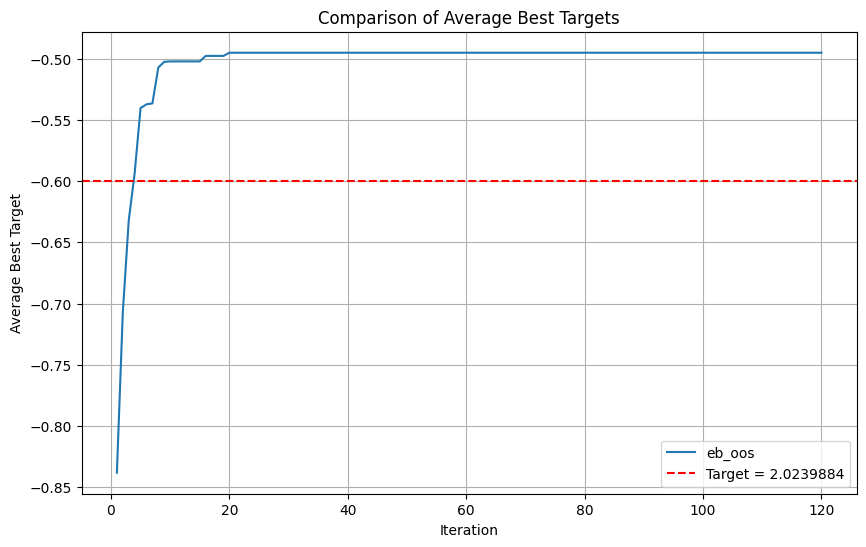

In [ ]:
# plot average best value evolution across 120 iterations of 30 MC runs for the 4 acquisition functions

# acq functions:
# 1 - eic_bm, gamma = 10
# 2 - eb, gamma = 1/sigma
# 3 - eb, gamma = 10
# 4 - eb, gamma = 1e+6

indeces = np.arange(niter)+1
# dataframes = [average_best_ei_, average_best_ei, average_best_oos, average_best_fix, average_best_fix2]
dataframes = [average_best_oos]
#labels = ['eic_bm_oos','eic_bm_fix10', 'eb_oos', 'eb_fix10', 'eb_fix1e6']
labels = ['eb_oos']

plt.figure(figsize=(10, 6))

for df, label in zip(dataframes, labels):
    plt.plot(indeces, df['average_best_target'], label=label)

plt.axhline(y=-0.5998, color='r', linestyle='--', label='Target = 2.0239884')
plt.grid()
plt.xlabel('Iteration')
plt.ylabel('Average Best Target')
plt.title('Comparison of Average Best Targets')
plt.legend()
plt.show()

In [ ]:
optimizer.max

{'target': -0.6017039121763262,
 'params': {'x': 0.20096169699887342, 'y': 0.4007422151774528}}